<a href="https://colab.research.google.com/github/ashok2216-A/Fruits_-_Vegetable_Recognition/blob/main/Fruits_%26_Vegetables_Image_Recognition.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Check GPU is Enabled Or Not

In [2]:
!nvidia-smi

Tue Jan 25 05:54:17 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.46       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Import Modules

In [3]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
plt.style.use('seaborn-darkgrid')
plt.style.use('dark_background')
plt.rc('figure', figsize=(10,10))
plt.rc('font', size=14)
plt.rc('lines', markersize=16)
import warnings 
warnings.filterwarnings('ignore')
import cv2
from google.colab.patches import cv2_imshow
import sklearn
from sklearn.model_selection import train_test_split
import tensorflow as tf
import datetime
!rm -rf ./logs/
%load_ext tensorboard
from tensorflow import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras import Sequential, layers, models
from tensorflow.keras import activations, losses, optimizers, metrics
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.activations import relu, sigmoid, softmax
from tensorflow.keras.losses import sparse_categorical_crossentropy
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, MaxPooling2D

In [4]:
from google.colab import files
uploaded = files.upload()

# Download Datas through kaggle API

In [5]:
os.environ['KAGGLE_USERNAME'] = "ashokkumarbibbab"
os.environ['KAGGLE_KEY'] = "5119a90edb5ff21e152ed5a195e1efc2"

In [6]:
!kaggle datasets download -d moltean/fruits

100% 1.28G/1.28G [00:08<00:00, 184MB/s]
100% 1.28G/1.28G [00:08<00:00, 160MB/s]


# Unzip Data folder

In [7]:
from zipfile import ZipFile

file_path = '/content/fruits.zip'
with ZipFile(file_path, 'r') as zip:
  print('Extracting...')
  zip.extractall()
  print('Done')

Extracting...
Done


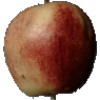

In [8]:
img = cv2.imread('/content/fruits-360_dataset/fruits-360/Training/Apple Red 3/100_100.jpg')
cv2_imshow(img)

In [9]:
os.chdir('/content/fruits-360_dataset/fruits-360')
os.getcwd()

'/content/fruits-360_dataset/fruits-360'

# Visualize each classes in Data

File Name: 248_100.jpg Name: Physalis with Husk


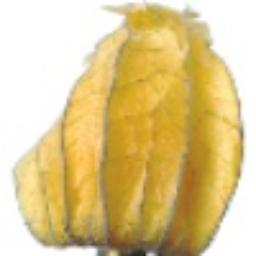


File Name: 248_100.jpg Name: Rambutan


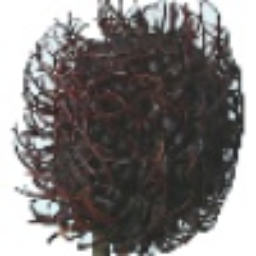


File Name: 152_100.jpg Name: Tomato Yellow


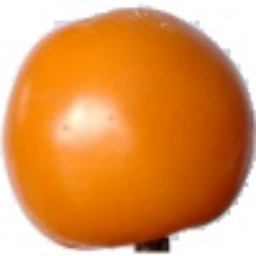


File Name: 248_100.jpg Name: Tomato 4


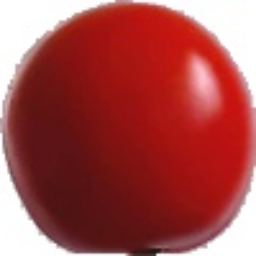


File Name: 248_100.jpg Name: Pomegranate


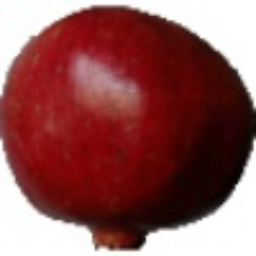


File Name: 262_100.jpg Name: Nut Pecan


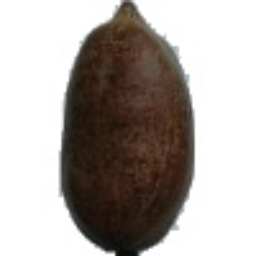


File Name: 248_100.jpg Name: Carambula


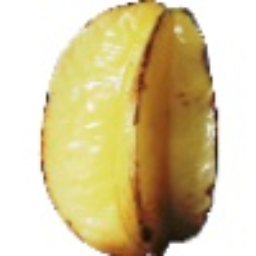


File Name: 262_100.jpg Name: Apple Red Yellow 2


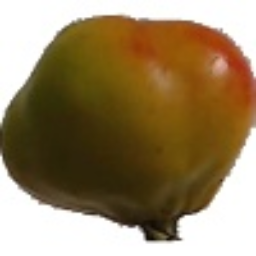


File Name: 248_100.jpg Name: Apple Golden 1


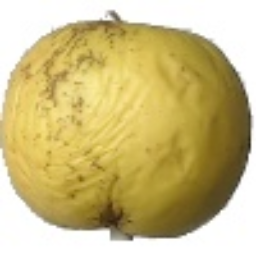


File Name: 262_100.jpg Name: Pear Abate


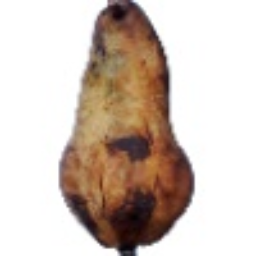


File Name: 36_100.jpg Name: Mandarine


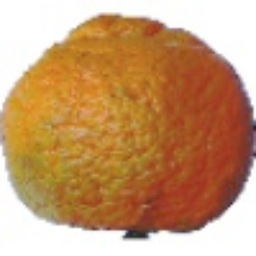


File Name: 248_100.jpg Name: Peach


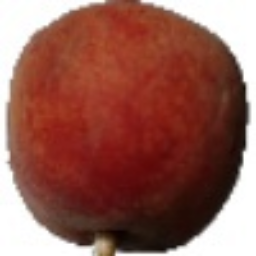


File Name: 248_100.jpg Name: Apple Braeburn


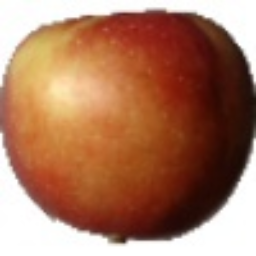


File Name: 248_100.jpg Name: Avocado ripe


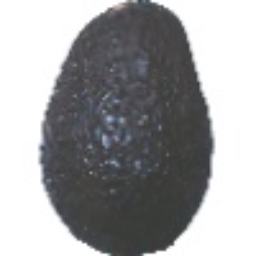


File Name: 248_100.jpg Name: Eggplant


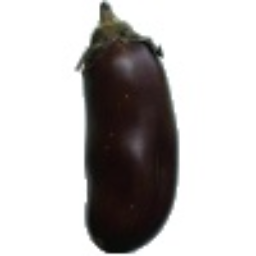


File Name: 248_100.jpg Name: Pear Monster


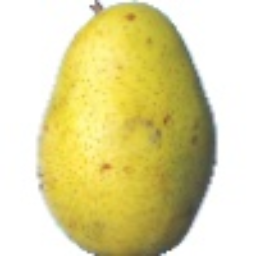


File Name: r2_143_100.jpg Name: Chestnut


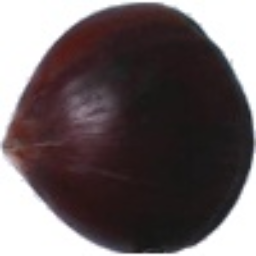


File Name: 248_100.jpg Name: Apricot


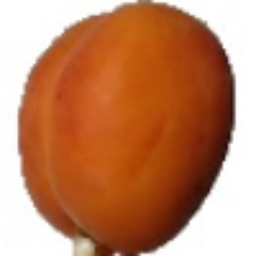


File Name: 248_100.jpg Name: Dates


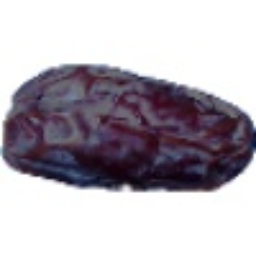


File Name: 152_100.jpg Name: Pear Williams


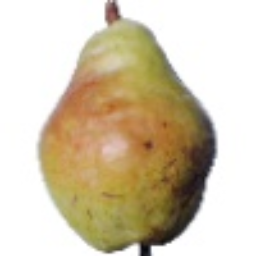


File Name: 248_100.jpg Name: Lychee


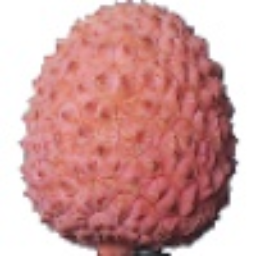


File Name: 152_100.jpg Name: Nectarine Flat


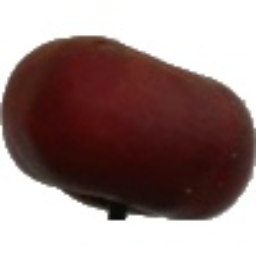


File Name: 152_100.jpg Name: Cherry Wax Red


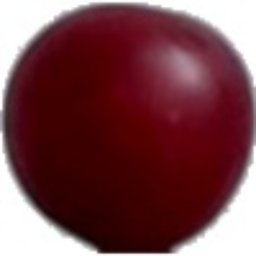


File Name: 248_100.jpg Name: Cantaloupe 1


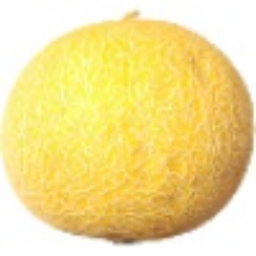


File Name: 248_100.jpg Name: Banana


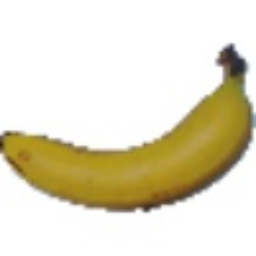


File Name: 248_100.jpg Name: Kohlrabi


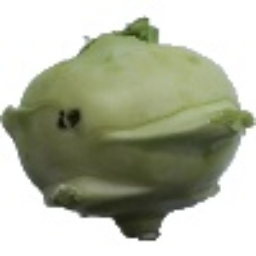


File Name: 248_100.jpg Name: Watermelon


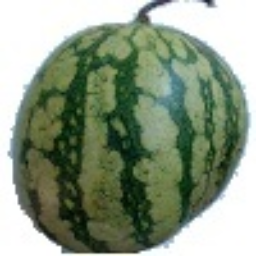


File Name: 248_100.jpg Name: Pepino


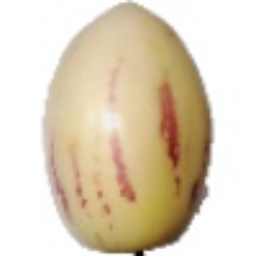


File Name: 248_100.jpg Name: Strawberry Wedge


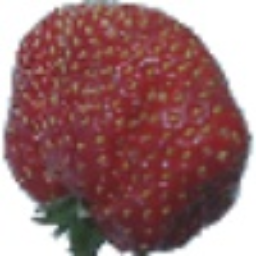


File Name: 152_100.jpg Name: Mango Red


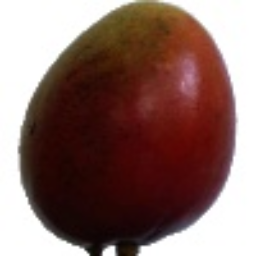


File Name: 262_100.jpg Name: Tomato Cherry Red


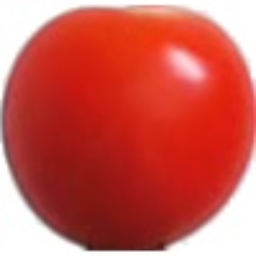


File Name: 248_100.jpg Name: Grape Pink


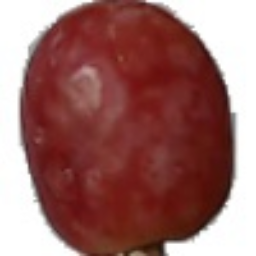


File Name: 248_100.jpg Name: Plum


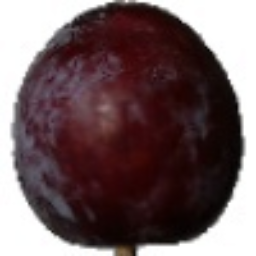


File Name: 152_100.jpg Name: Apple Red 3


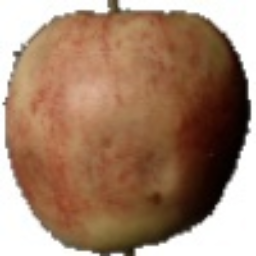


File Name: 248_100.jpg Name: Apple Granny Smith


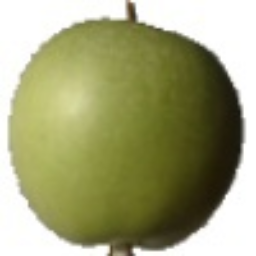


File Name: 248_100.jpg Name: Kaki


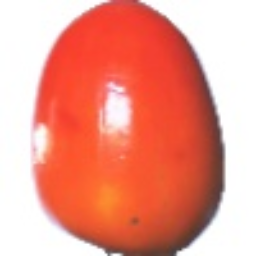


File Name: 248_100.jpg Name: Grape Blue


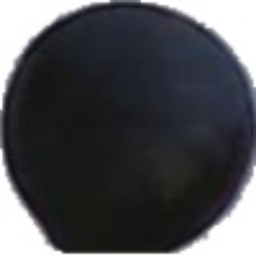


File Name: 248_100.jpg Name: Cucumber Ripe 2


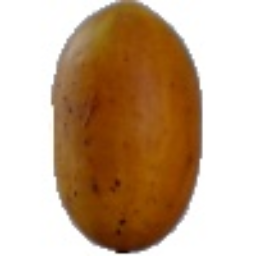


File Name: 248_100.jpg Name: Cherry Rainier


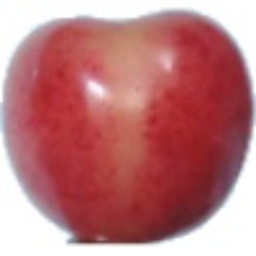


File Name: 248_100.jpg Name: Nut Forest


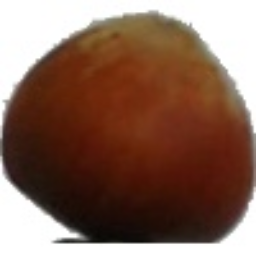


File Name: 248_100.jpg Name: Strawberry


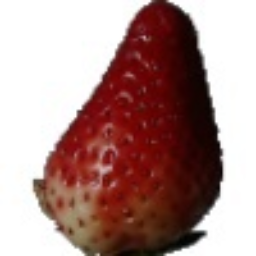


File Name: 248_100.jpg Name: Blueberry


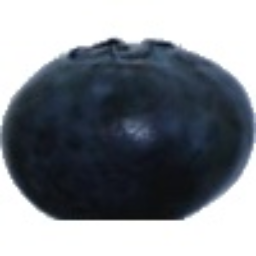


File Name: 248_100.jpg Name: Banana Red


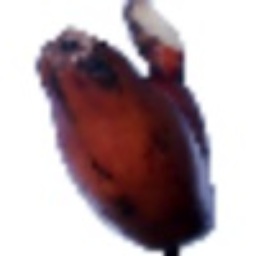


File Name: 248_100.jpg Name: Cauliflower


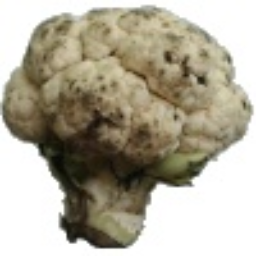


File Name: 248_100.jpg Name: Guava


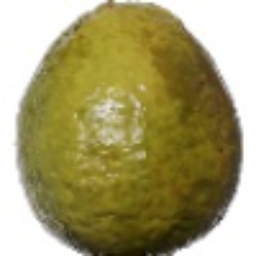


File Name: 152_100.jpg Name: Pomelo Sweetie


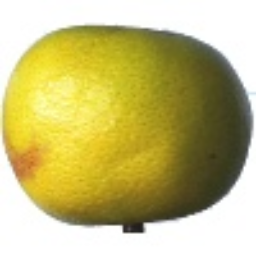


File Name: 248_100.jpg Name: Cocos


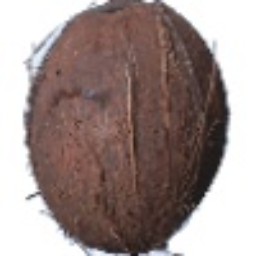


File Name: 152_100.jpg Name: Potato White


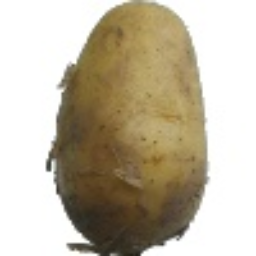


File Name: 262_100.jpg Name: Tangelo


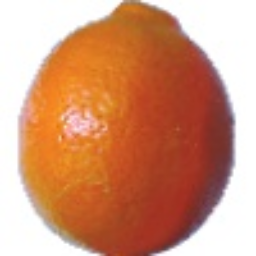


File Name: 248_100.jpg Name: Pear


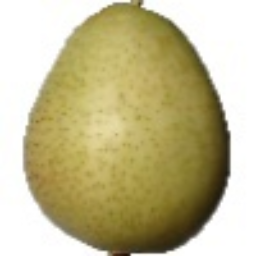


File Name: 248_100.jpg Name: Apple Red Delicious


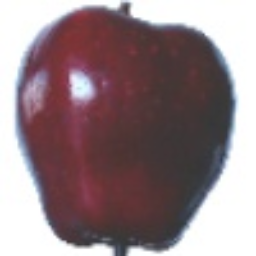


File Name: 248_100.jpg Name: Peach Flat


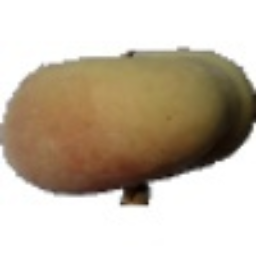


File Name: 152_100.jpg Name: Tomato 2


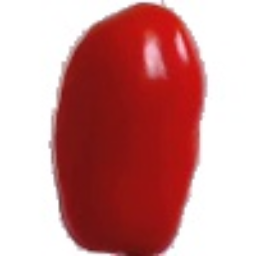


File Name: 248_100.jpg Name: Apple Crimson Snow


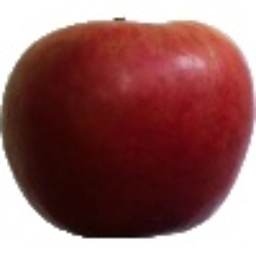


File Name: 248_100.jpg Name: Pineapple Mini


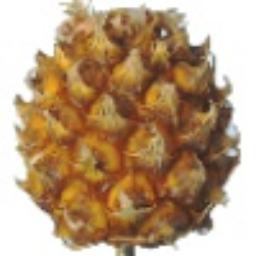


File Name: 152_100.jpg Name: Apple Pink Lady


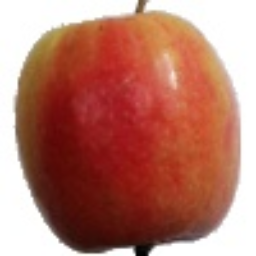


File Name: 152_100.jpg Name: Melon Piel de Sapo


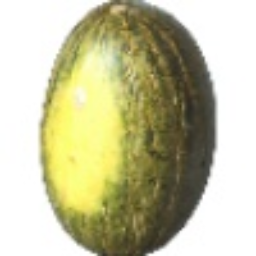


File Name: 248_100.jpg Name: Cherry 1


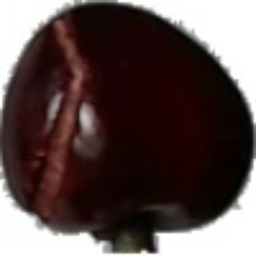


File Name: 248_100.jpg Name: Apple Golden 2


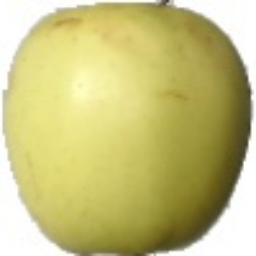


File Name: 152_100.jpg Name: Ginger Root


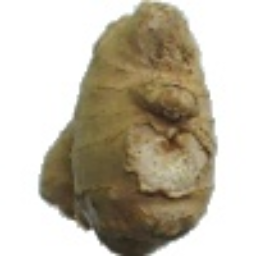


File Name: 152_100.jpg Name: Potato Red


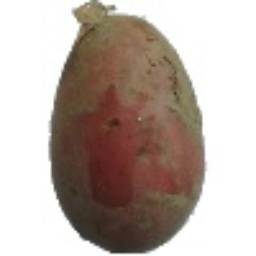


File Name: 248_100.jpg Name: Nectarine


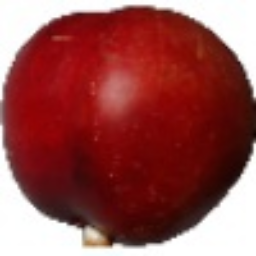


File Name: 248_100.jpg Name: Peach 2


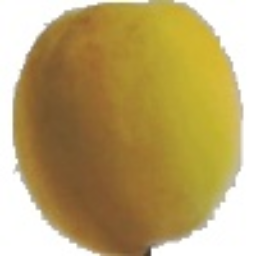


File Name: 262_100.jpg Name: Mulberry


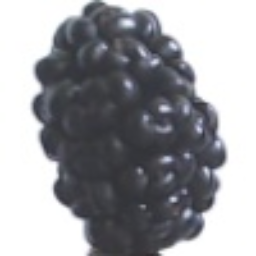


File Name: r_111_100.jpg Name: Pear Kaiser


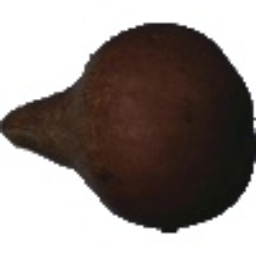


File Name: 248_100.jpg Name: Quince


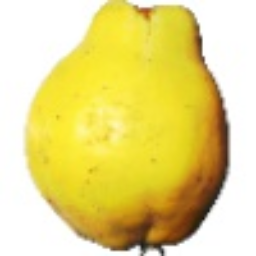


File Name: 152_100.jpg Name: Corn


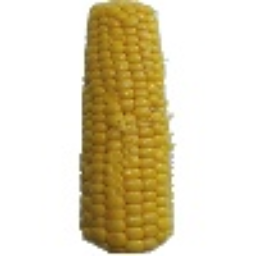


File Name: 248_100.jpg Name: Orange


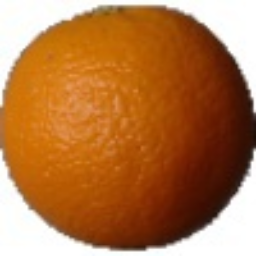


File Name: 152_100.jpg Name: Onion White


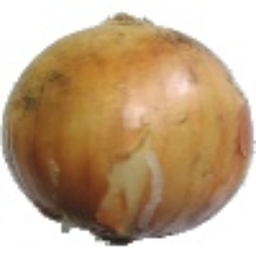


File Name: 152_100.jpg Name: Pear Stone


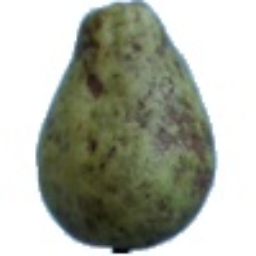


File Name: 248_100.jpg Name: Plum 2


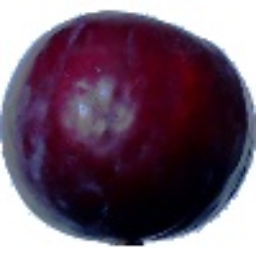


File Name: 262_100.jpg Name: Pear Red


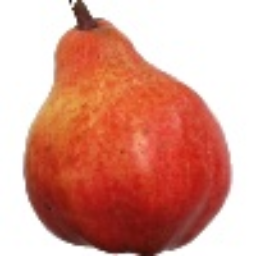


File Name: 248_100.jpg Name: Lemon


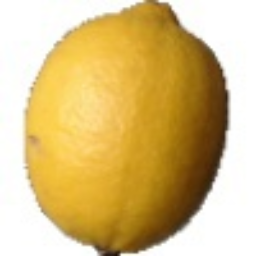


File Name: 248_100.jpg Name: Cherry Wax Black


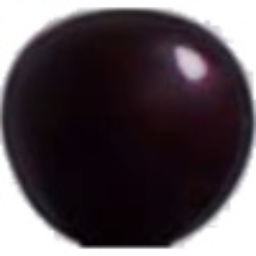


File Name: 248_100.jpg Name: Passion Fruit


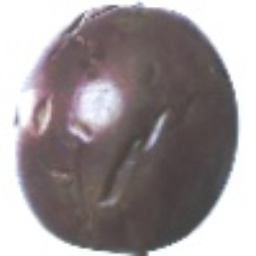


File Name: 248_100.jpg Name: Huckleberry


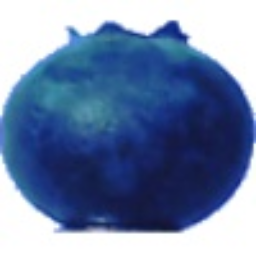


File Name: 248_100.jpg Name: Grape White 4


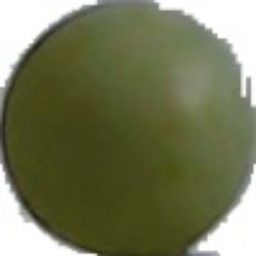


File Name: 248_100.jpg Name: Pepper Orange


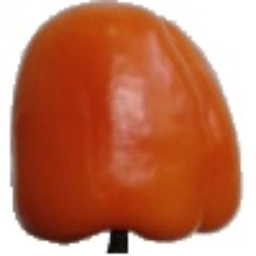


File Name: 248_100.jpg Name: Grape White 2


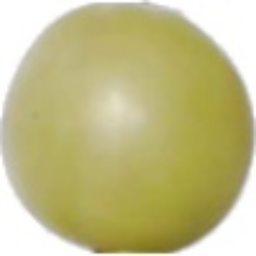


File Name: r_111_100.jpg Name: Potato Sweet


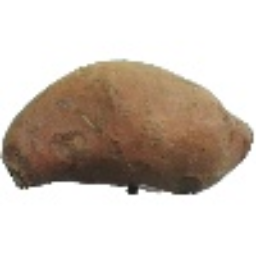


File Name: 248_100.jpg Name: Tomato 1


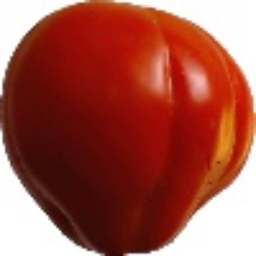


File Name: 248_100.jpg Name: Apple Red 1


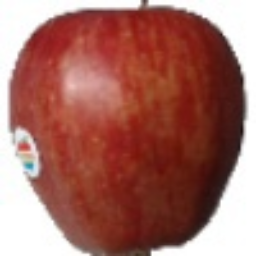


File Name: 248_100.jpg Name: Salak


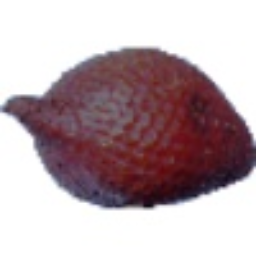


File Name: 152_100.jpg Name: Cherry Wax Yellow


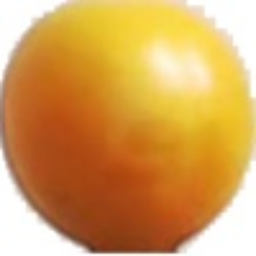


File Name: 248_100.jpg Name: Physalis


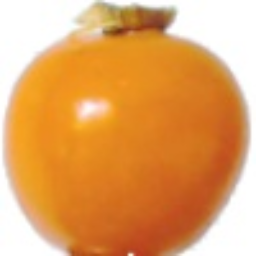


File Name: 248_100.jpg Name: Pepper Yellow


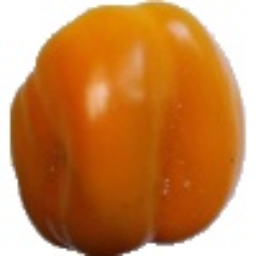


File Name: 152_100.jpg Name: Onion Red Peeled


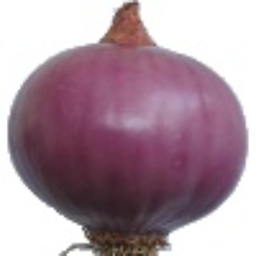


File Name: 36_100.jpg Name: Corn Husk


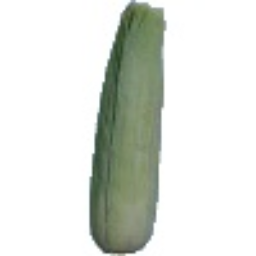


File Name: 152_100.jpg Name: Beetroot


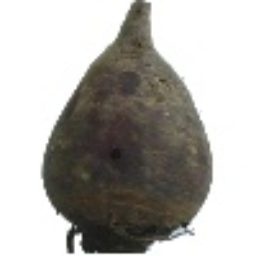


File Name: 248_100.jpg Name: Apple Red 2


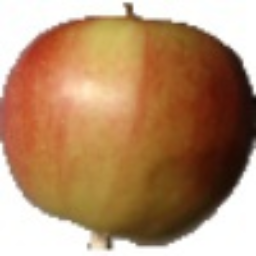


File Name: 248_100.jpg Name: Cucumber Ripe


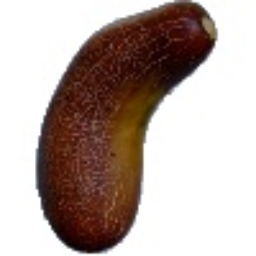


File Name: 152_100.jpg Name: Avocado


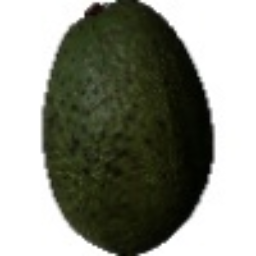


File Name: 248_100.jpg Name: Apple Golden 3


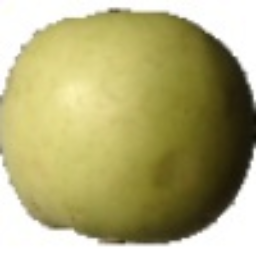


File Name: 248_100.jpg Name: Apple Red Yellow 1


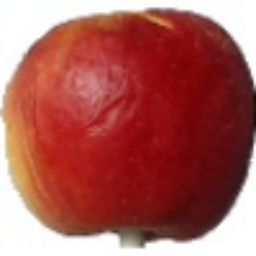


File Name: 248_100.jpg Name: Redcurrant


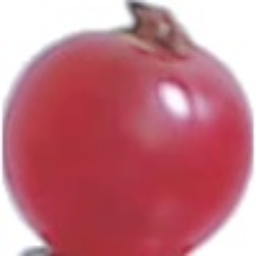


File Name: 248_100.jpg Name: Tamarillo


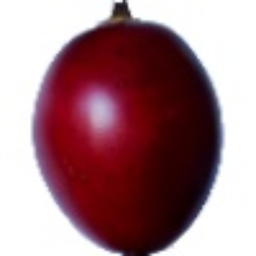


File Name: 248_100.jpg Name: Grapefruit White


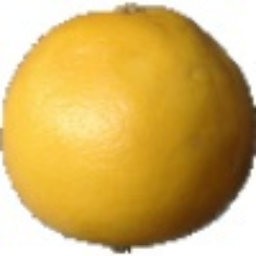


File Name: 248_100.jpg Name: Tomato 3


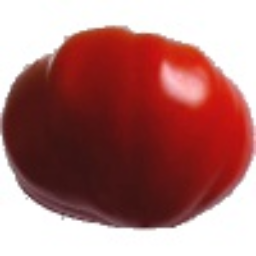


File Name: 248_100.jpg Name: Pineapple


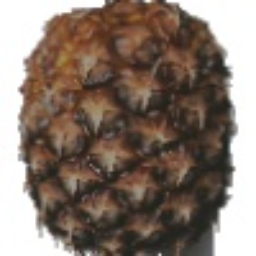


File Name: 248_100.jpg Name: Lemon Meyer


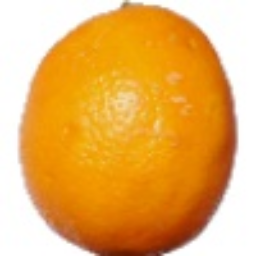


File Name: 248_100.jpg Name: Kumquats


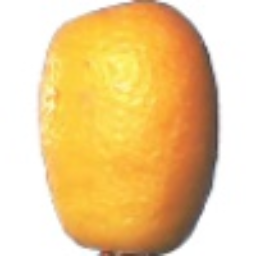


File Name: 248_100.jpg Name: Grape White


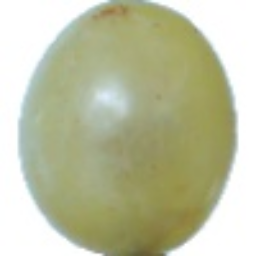


File Name: 248_100.jpg Name: Clementine


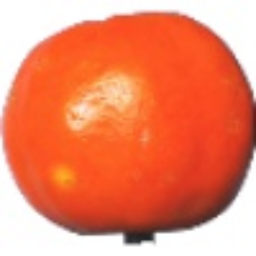


File Name: 248_100.jpg Name: Fig


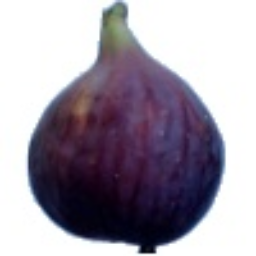


File Name: 248_100.jpg Name: Pepper Green


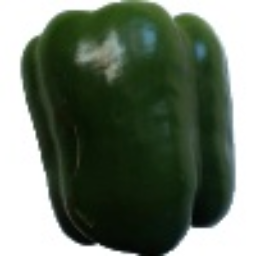


File Name: 248_100.jpg Name: Cantaloupe 2


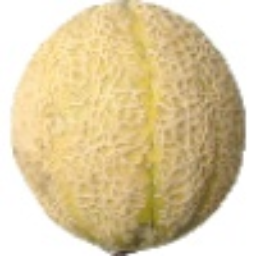


File Name: 248_100.jpg Name: Limes


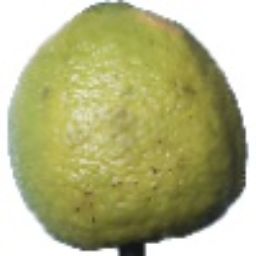


File Name: 248_100.jpg Name: Papaya


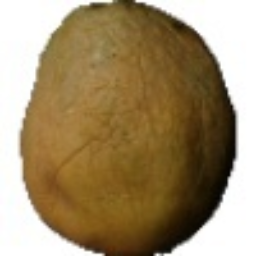


File Name: 248_100.jpg Name: Grapefruit Pink


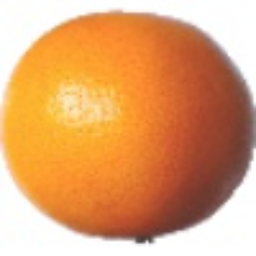


File Name: 248_100.jpg Name: Pear Forelle


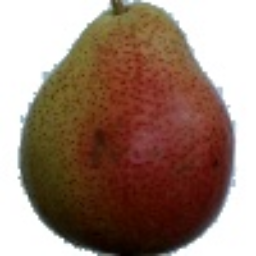


File Name: 248_100.jpg Name: Mango


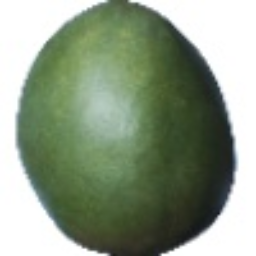


File Name: 152_100.jpg Name: Potato Red Washed


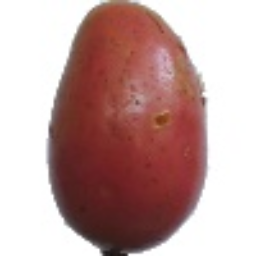


File Name: r_111_100.jpg Name: Banana Lady Finger


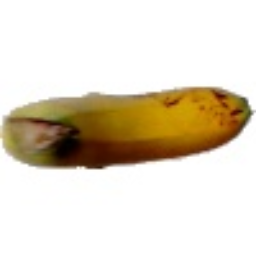


File Name: r3_167_100.jpg Name: Plum 3


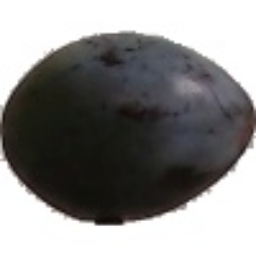


File Name: 248_100.jpg Name: Granadilla


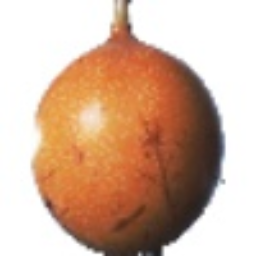


File Name: 248_100.jpg Name: Walnut


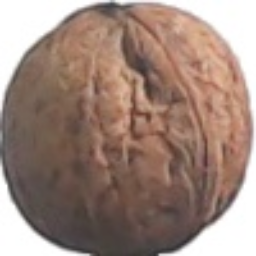


File Name: 248_100.jpg Name: Hazelnut


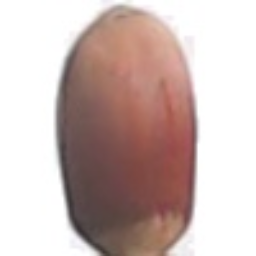


File Name: 248_100.jpg Name: Maracuja


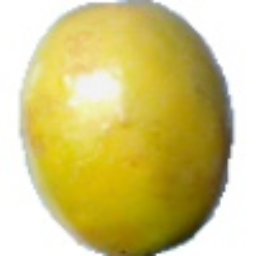


File Name: 248_100.jpg Name: Kiwi


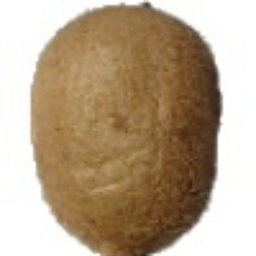


File Name: 152_100.jpg Name: Pitahaya Red


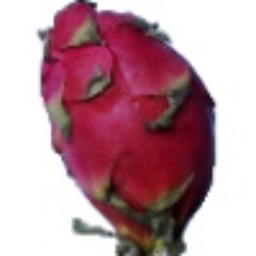


File Name: 152_100.jpg Name: Cactus fruit


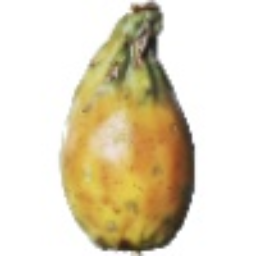


File Name: 262_100.jpg Name: Tomato Heart


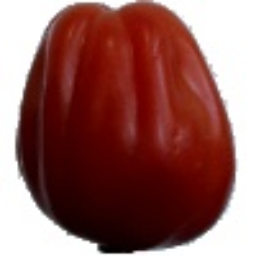


File Name: 248_100.jpg Name: Cherry 2


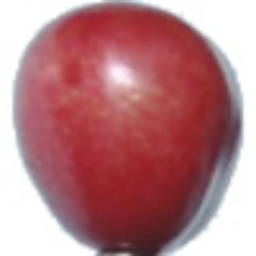


File Name: 248_100.jpg Name: Pear 2


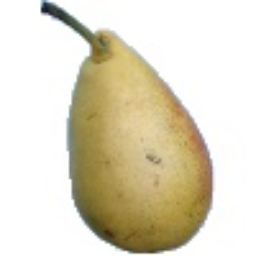


File Name: 248_100.jpg Name: Grape White 3


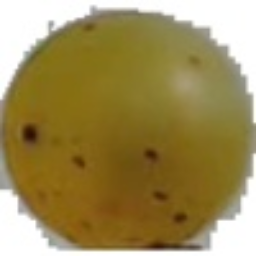


File Name: 152_100.jpg Name: Onion Red


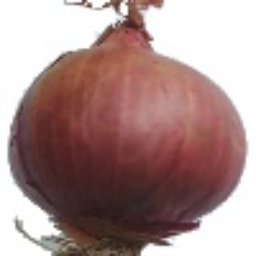


File Name: 36_100.jpg Name: Mangostan


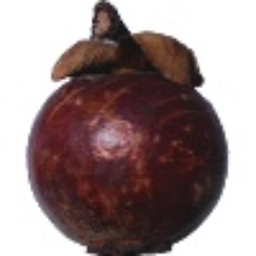


File Name: 248_100.jpg Name: Raspberry


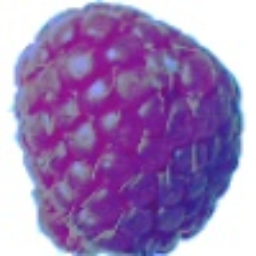


File Name: 262_100.jpg Name: Tomato Maroon


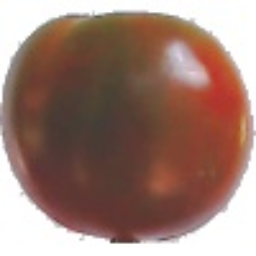


File Name: 248_100.jpg Name: Tomato not Ripened


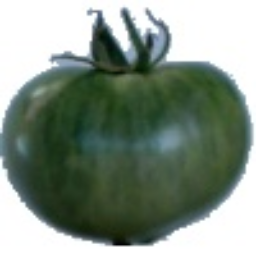


File Name: r_111_100.jpg Name: Pepper Red


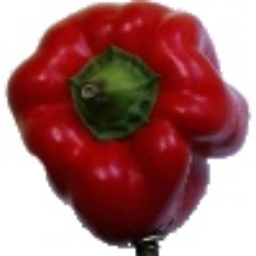

In [10]:
plt.rc('figure', figsize=(5,5))
CATEGORIES = list(os.listdir('/content/fruits-360_dataset/fruits-360/Training'))
DATADIR = '/content/fruits-360_dataset/fruits-360/Training'

for category in CATEGORIES:
  path = os.path.join(DATADIR, category)
  img_path = os.listdir(path)
  for img in img_path[0:1]:
    print('File Name:', img,'Name:',category)
    #gray_img_array = cv2.imread(os.path.join(path, img), cv2.IMREAD_GRAYSCALE)
    rgb_img_array = cv2.imread(os.path.join(path, img))
    rgb_img_array = cv2.resize(rgb_img_array, (256,256))
    cv2_imshow(rgb_img_array)
    print('')
    plt.show()
    break

# Count Number of images in each classes

In [11]:
imgs_count = []

for category in CATEGORIES:
  path = os.path.join(DATADIR, category)
  img_count = len(os.listdir(path))
  print('Count:',img_count,'--','Name:',category)
  val = (category, img_count)
  imgs_count.append(val)

Count: 492 -- Name: Physalis with Husk
Count: 492 -- Name: Rambutan
Count: 459 -- Name: Tomato Yellow
Count: 479 -- Name: Tomato 4
Count: 492 -- Name: Pomegranate
Count: 534 -- Name: Nut Pecan
Count: 490 -- Name: Carambula
Count: 672 -- Name: Apple Red Yellow 2
Count: 480 -- Name: Apple Golden 1
Count: 490 -- Name: Pear Abate
Count: 490 -- Name: Mandarine
Count: 492 -- Name: Peach
Count: 492 -- Name: Apple Braeburn
Count: 491 -- Name: Avocado ripe
Count: 468 -- Name: Eggplant
Count: 490 -- Name: Pear Monster
Count: 450 -- Name: Chestnut
Count: 492 -- Name: Apricot
Count: 490 -- Name: Dates
Count: 490 -- Name: Pear Williams
Count: 490 -- Name: Lychee
Count: 480 -- Name: Nectarine Flat
Count: 492 -- Name: Cherry Wax Red
Count: 492 -- Name: Cantaloupe 1
Count: 490 -- Name: Banana
Count: 471 -- Name: Kohlrabi
Count: 475 -- Name: Watermelon
Count: 490 -- Name: Pepino
Count: 738 -- Name: Strawberry Wedge
Count: 426 -- Name: Mango Red
Count: 492 -- Name: Tomato Cherry Red
Count: 492 -- Name: 

# Create a dataframe

In [12]:
img_counts = pd.DataFrame(imgs_count, columns=['Fruits','Counts'])
img_counts

,Fruits,Counts
0,Physalis with Husk,492
1,Rambutan,492
2,Tomato Yellow,459
3,Tomato 4,479
4,Pomegranate,492
...,...,...
126,Mangostan,300
127,Raspberry,490
128,Tomato Maroon,367
129,Tomato not Ripened,474


# Visualize Number of fruits by using scatter plot

In [13]:
fig = px.scatter(data_frame=img_counts, x='Fruits', y='Counts', color='Fruits', template='plotly_dark')
fig.show()

# In barplot

In [14]:
fig = px.bar(data_frame=img_counts, x='Fruits', y='Counts', color='Fruits', template='plotly_dark')
fig.show()

# Create Train and Validation datas from directory

In [16]:
image_size = (200,200)
batch_size = 32
 
train_data = tf.keras.preprocessing.image_dataset_from_directory(
                                        "/content/fruits-360_dataset/fruits-360/Training",
                                        validation_split=0.050,
                                        subset="training",
                                        seed=1337,
                                        image_size=image_size,
                                        batch_size=batch_size,
                                                         )
 
 
validation_data = tf.keras.preprocessing.image_dataset_from_directory(
                                        "/content/fruits-360_dataset/fruits-360/Validation",
                                        validation_split=0.9,
                                        subset="validation", 
                                        seed=1337,
                                        image_size=image_size,
                                        batch_size=batch_size,
                                                              )

Found 67692 files belonging to 131 classes.
Using 64308 files for training.
Found 22688 files belonging to 131 classes.
Using 20419 files for validation.


In [17]:
label_dict = train_data.class_names

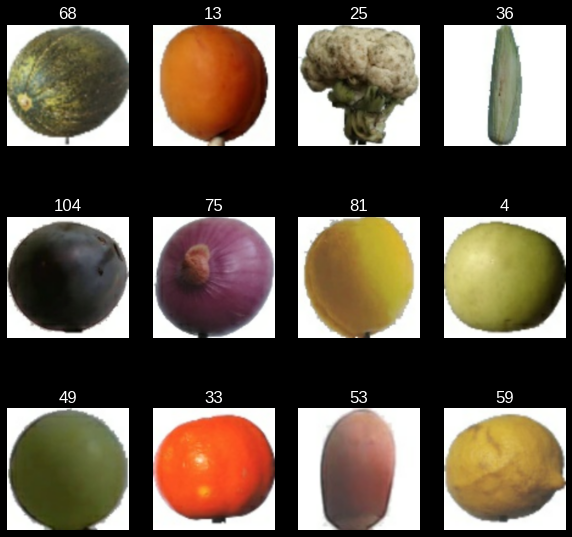

In [54]:
plt.figure(figsize=(10, 10))
for images, labels in train_data.take(1):
    for i in range(12):
        ax = plt.subplot(3, 4, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

# We should Add a Data Augmentation, otherwise the model will be overfit

In [19]:
data_augmentation = tf.keras.Sequential(
  [
    layers.RandomFlip("horizontal",
                      input_shape=(200,
                                  200,
                                  3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
  ]
)

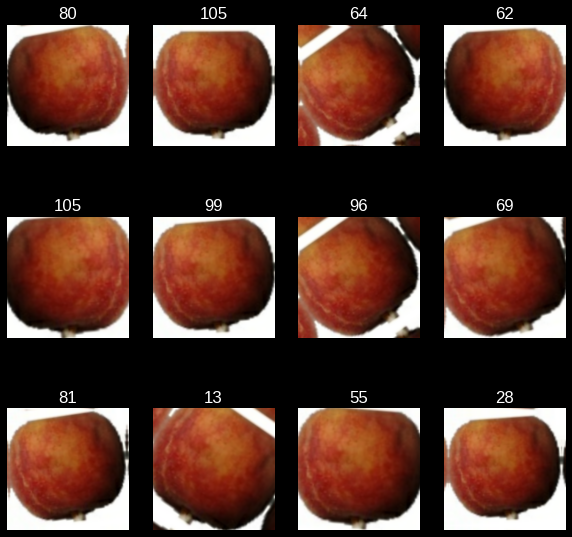

In [53]:
plt.figure(figsize=(10, 10))
for images, labels in train_data.take(1):
    for i in range(12):
        augmented_images = data_augmentation(images)
        ax = plt.subplot(3, 4, i + 1)
        plt.imshow(augmented_images[0].numpy().astype("uint8"))
        plt.title(int(labels[i]))
        plt.axis("off")

# Build a Neural Network

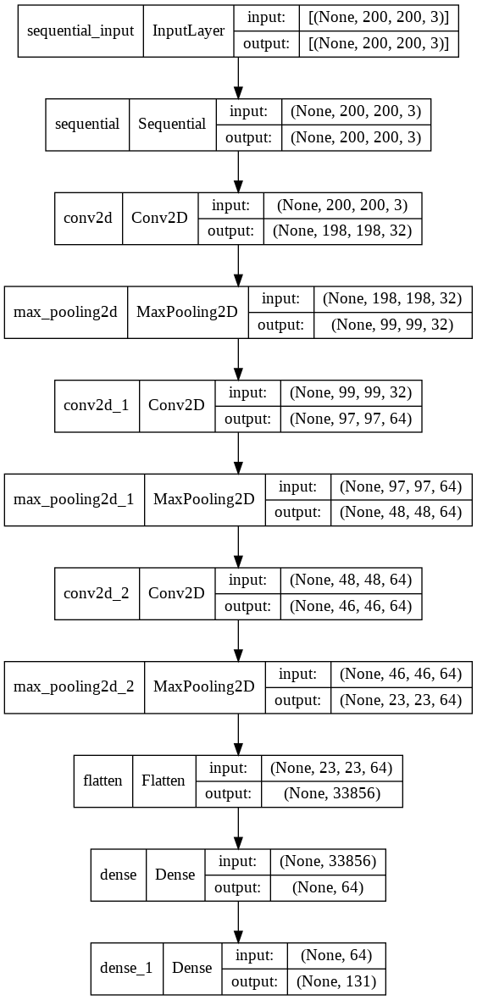

In [23]:
model = tf.keras.Sequential([
    data_augmentation,
    layers.Conv2D(filters=32, kernel_size=(3, 3), activation='relu', input_shape=(200, 200, 3)),
    layers.MaxPooling2D((2, 2)),
    
    layers.Conv2D(filters=64, kernel_size=(3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),

    layers.Conv2D(filters=64, kernel_size=(3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),

    layers.Flatten(),
    layers.Dense(64, activation='relu'),
    layers.Dense(131, activation='softmax')
    
])
keras.utils.plot_model(model, show_shapes=True)

In [24]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential (Sequential)     (None, 200, 200, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 198, 198, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 99, 99, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 97, 97, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 48, 48, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 46, 46, 64)       

# Visualize the output images of the every layers before model training
**Conv2d and Maxpooling**

(1, 200, 200, 3)


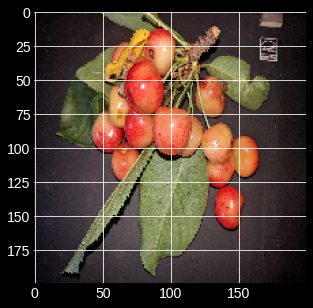

In [25]:
img_path='/content/fruits-360_dataset/fruits-360/test-multiple_fruits/cherries(rainier)1.jpg'
img = image.load_img(img_path, target_size = (200, 200))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis = 0)
img_tensor = img_tensor / 255.

# Print image tensor shape
print(img_tensor.shape)

# Print image
plt.rc('figure', figsize=(5,5))
plt.imshow(img_tensor[0])
plt.show()

outputs>>> layer_name: conv2d_2 	 layer_shape: (1, 46, 46, 64)


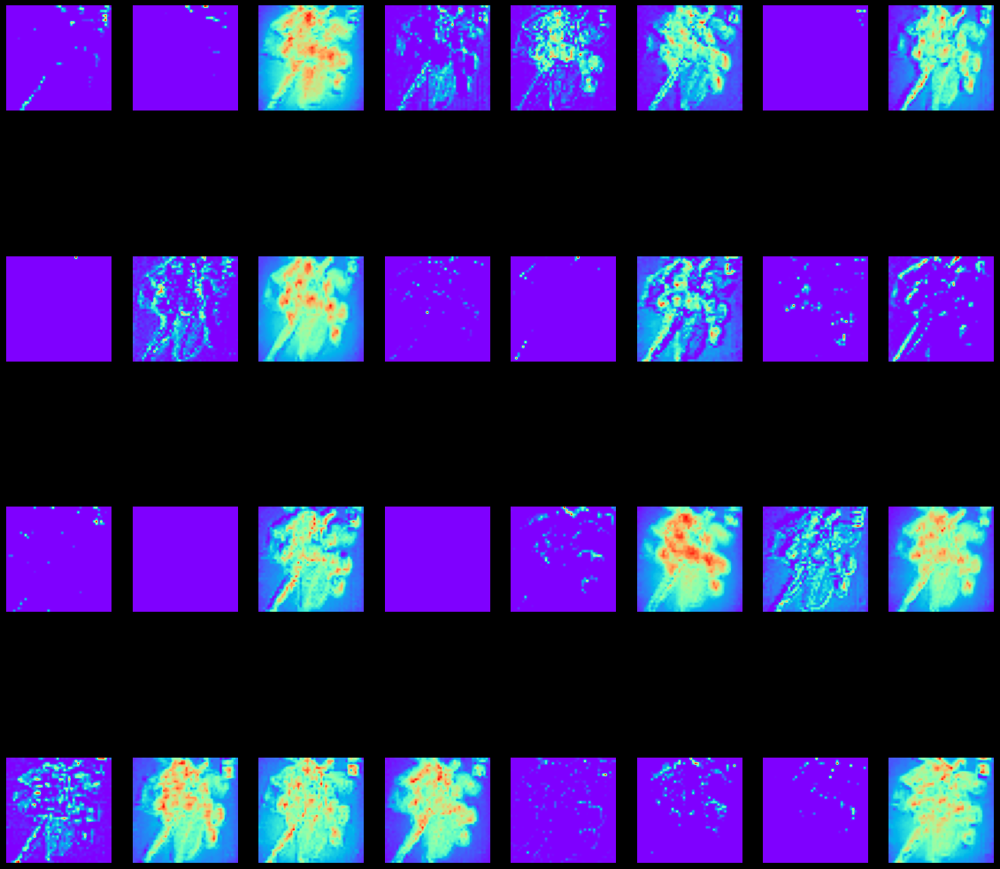

In [29]:
plt.rc('figure', figsize=(20,20))

select_layer = model.layers[5:] #select the layers here
layer_outputs = [layer.output for layer in select_layer]
activation_model = models.Model(inputs = model.input, outputs = layer_outputs)
activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]
#print(first_layer_activation.shape)
for i in range(32):
  ax = plt.subplot(4,8, i + 1)
  plt.imshow(first_layer_activation[0, :, :, i], cmap='rainbow')
  #plt.title(lay_name)
  plt.axis("off")
  #plt.colorbar()
lay_name = []
for lay in select_layer:
  lay_name.append(lay.name)
print('outputs>>>','layer_name:',lay_name[0],'\t','layer_shape:',first_layer_activation.shape)

# Set an Optimizers and Losses

In [30]:
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Train our model

In [32]:
checkpoint_filepath = 'model-{epoch:03d}.h5'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath)

model.fit(train_data, validation_data=validation_data, epochs=5, callbacks=[model_checkpoint_callback])

Epoch 1/5
2010/2010 [==============================] - 99s 49ms/step - loss: 0.1905 - accuracy: 0.9412 - val_loss: 0.3821 - val_accuracy: 0.9200
Epoch 2/5
2010/2010 [==============================] - 99s 49ms/step - loss: 0.1852 - accuracy: 0.9445 - val_loss: 0.4474 - val_accuracy: 0.9005
Epoch 3/5
2010/2010 [==============================] - 98s 49ms/step - loss: 0.1688 - accuracy: 0.9502 - val_loss: 0.3120 - val_accuracy: 0.9445
Epoch 4/5
2010/2010 [==============================] - 98s 49ms/step - loss: 0.1656 - accuracy: 0.9526 - val_loss: 0.4775 - val_accuracy: 0.9043
Epoch 5/5
2010/2010 [==============================] - 100s 50ms/step - loss: 0.1472 - accuracy: 0.9579 - val_loss: 0.6862 - val_accuracy: 0.8854


# Visualize the output images of the every layers after training
**Conv2d and Maxpooling**

(1, 200, 200, 3)


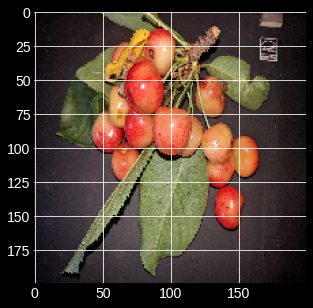

In [55]:
img_path='/content/fruits-360_dataset/fruits-360/test-multiple_fruits/cherries(rainier)1.jpg'
img = image.load_img(img_path, target_size = (200,200))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis = 0)
img_tensor = img_tensor / 255.

# Print image tensor shape
print(img_tensor.shape)

# Print image
plt.rc('figure', figsize=(5,5))
plt.imshow(img_tensor[0])
plt.show()

layer_name: max_pooling2d 	 layer_shape: (1, 99, 99, 32)


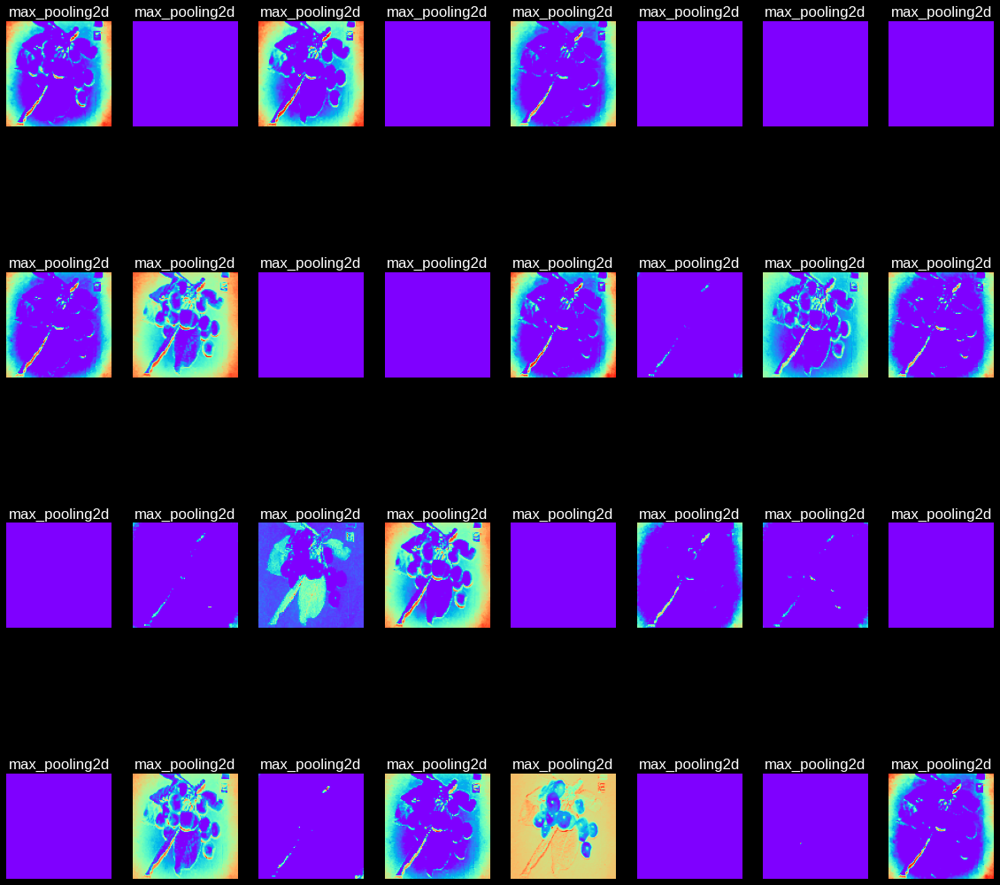

In [56]:
plt.rc('figure', figsize=(20,20))

select_layer = model.layers[2:] #select the layers here
layer_outputs = [layer.output for layer in select_layer]
activation_model = models.Model(inputs = model.input, outputs = layer_outputs)
activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]
#print(first_layer_activation.shape)
lay_name = []
for lay in select_layer:
  lay_name.append(lay.name)
print('layer_name:',lay_name[0],'\t','layer_shape:',first_layer_activation.shape)
for i in range(32):
  ax = plt.subplot(4,8, i + 1)
  plt.imshow(first_layer_activation[0, :, :, i], cmap='rainbow')
  plt.title(lay_name[0])
  plt.axis("off")
  #plt.colorbar()


In [35]:
layer_names = []
for layer in model.layers[:8]:
  layer_names.append(layer.name)
  print(layer_names)

['sequential']
['sequential', 'conv2d']
['sequential', 'conv2d', 'max_pooling2d']
['sequential', 'conv2d', 'max_pooling2d', 'conv2d_1']
['sequential', 'conv2d', 'max_pooling2d', 'conv2d_1', 'max_pooling2d_1']
['sequential', 'conv2d', 'max_pooling2d', 'conv2d_1', 'max_pooling2d_1', 'conv2d_2']
['sequential', 'conv2d', 'max_pooling2d', 'conv2d_1', 'max_pooling2d_1', 'conv2d_2', 'max_pooling2d_2']
['sequential', 'conv2d', 'max_pooling2d', 'conv2d_1', 'max_pooling2d_1', 'conv2d_2', 'max_pooling2d_2', 'flatten']


In [37]:
layer_outputs = [layer.output for layer in model.layers]
layer_outputs

[<KerasTensor: shape=(None, 200, 200, 3) dtype=float32 (created by layer 'random_zoom')>,
 <KerasTensor: shape=(None, 198, 198, 32) dtype=float32 (created by layer 'conv2d')>,
 <KerasTensor: shape=(None, 99, 99, 32) dtype=float32 (created by layer 'max_pooling2d')>,
 <KerasTensor: shape=(None, 97, 97, 64) dtype=float32 (created by layer 'conv2d_1')>,
 <KerasTensor: shape=(None, 48, 48, 64) dtype=float32 (created by layer 'max_pooling2d_1')>,
 <KerasTensor: shape=(None, 46, 46, 64) dtype=float32 (created by layer 'conv2d_2')>,
 <KerasTensor: shape=(None, 23, 23, 64) dtype=float32 (created by layer 'max_pooling2d_2')>,
 <KerasTensor: shape=(None, 33856) dtype=float32 (created by layer 'flatten')>,
 <KerasTensor: shape=(None, 64) dtype=float32 (created by layer 'dense')>,
 <KerasTensor: shape=(None, 131) dtype=float32 (created by layer 'dense_1')>]

# Evaluate our model

In [38]:
model.evaluate(train_data)

2010/2010 [==============================] - 55s 27ms/step - loss: 0.1719 - accuracy: 0.9537


[0.17193973064422607, 0.9536916017532349]

# Validate our model

In [39]:
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

model.fit(train_data, 
          epochs=2, 
          validation_data=validation_data, 
          callbacks=[tensorboard_callback])

Epoch 1/2
2010/2010 [==============================] - 100s 49ms/step - loss: 0.1460 - accuracy: 0.9582 - val_loss: 0.5401 - val_accuracy: 0.9010
Epoch 2/2
2010/2010 [==============================] - 97s 48ms/step - loss: 0.1615 - accuracy: 0.9571 - val_loss: 0.4399 - val_accuracy: 0.9263


# Visualize Accuracy and losses in Tensorboard

In [40]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

# Load the saved model

In [42]:
model = load_model('/content/fruits-360_dataset/fruits-360/model-005.h5')

# Test your model if it is predicted correcly, we can ready to deploy

Predicted: 27
Score: 27


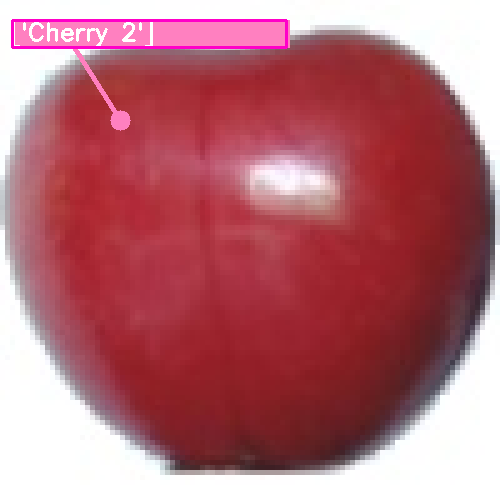

Class Name Predicted: ['Cherry 2']


In [214]:
plt.rc('figure', figsize=(5,5))
file_path = '/content/fruits-360_dataset/fruits-360/Validation/Cherry 2/19_100.jpg'

img = keras.preprocessing.image.load_img(
    file_path, target_size=image_size
)
img_array = keras.preprocessing.image.img_to_array(img)
img_array = tf.expand_dims(img_array, 0)  # Create batch axis
 
predictions = model.predict(img_array)
score = predictions[0]
classes = []
for labels in label_dict:
    classes.append(labels)
classes = np.array(pd.DataFrame(classes))
print('Predicted:',predictions.argmax())
print('Score:',score.argmax())
imgs = cv2.imread(file_path)
width = 500
height = 500
imgs = cv2.resize(imgs, (width, height),interpolation=cv2.INTER_AREA)
imgs =cv2.rectangle(imgs, pt1=(12,47), pt2=(289,20), color=(192,128,255), thickness=-1)
imgs = cv2.line(imgs, pt1 = (120, 120), pt2 = (60, 25), color= (192,128,255), thickness = 3)
imgs = cv2.circle(img = imgs, center = (120, 120), radius = 10, color = (192,128,255), thickness = -1)
imgs =  cv2.putText(img = imgs, text = str(classes[predictions.argmax()]), org=(10,40), 
                    fontFace=cv2.FONT_HERSHEY_SIMPLEX, fontScale = 0.8, color = (255, 255, 255), thickness = 2)
imgs =cv2.rectangle(imgs, pt1=(12,47), pt2=(286,20), color=(200,0,255), thickness=2)
cv2_imshow(imgs)
print('Class Name Predicted:', classes[predictions.argmax()])

# Thank you!